In [1]:
import networkx as nx
import random
import itertools
import numpy as np
import pandas as pd
from collections import Counter


import matplotlib.pyplot as plt
%matplotlib inline


['l', 'i', 'j', 'k']


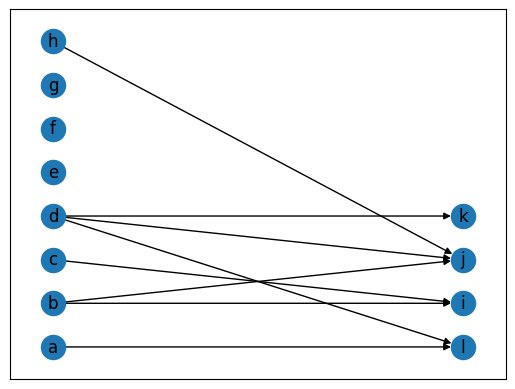

In [2]:
L1_nodes = ["a", "b", "c", "d", "e", "f", "g", "h"]
L2_nodes = ["i", "j", "k", "l", "m", "n", "o", "p","q", "r", "s", "t"]
L2_nodes = ["i", "j", "k", "l", "m", "n", "o", "p"]
L2_nodes = ["i", "j", "k", "l"]
L1L2Product = itertools.product(L1_nodes, L2_nodes)
edge_count = random.randrange(int(len(L1_nodes)/2), int(len(L1_nodes)*2))
edges = random.sample(list(L1L2Product),edge_count)

sorted(edges, key = lambda x : x[0])
assigned=set()
ordered=[]
for i,n in enumerate(L1_nodes):
    for s,f in sorted(edges, key = lambda x : x[0]):
        if s==n and f not in assigned:
            latest = len(assigned)
            if i > latest:
                for j in range(latest, i-1):
                    ordered.insert(i,f"_")
            ordered.insert(i,f)
            assigned.add(f)

ordered = [o for o in ordered if o != "_"]



for v in sorted(list(set(L2_nodes).difference(assigned))):
    
    try:
        ordered[ordered.index("_")]=v
    except ValueError:
        if v not in ordered:
            ordered.append(v)

print(ordered)
pos = {}
for e,n in enumerate(L1_nodes):
    pos[n]=(0,e)

for e,n in enumerate(ordered):
    pos[n]=(1,e)     

g = nx.DiGraph()
for n in L1_nodes + L2_nodes:
    g.add_node(n)
for e in edges:
    pass
    g.add_edge(*e)

nx.draw_networkx(g, pos=pos)



In [3]:
reassigned=set()
reordered=[]
for i,n in enumerate(ordered):
    for f,s in sorted(edges, key = lambda x : x[0]):
        if s==n and f not in reassigned:
            latest = len(reassigned)
            if i > latest:
                for j in range(latest, i-1):
                    reordered.insert(i,f"_")
            reordered.insert(i,f)
            reassigned.add(f)

reordered = [o for o in reordered if o != "_"]
reordered

['d', 'c', 'h', 'b', 'a']

['d', 'c', 'h', 'b', 'a', 'e', 'f', 'g']


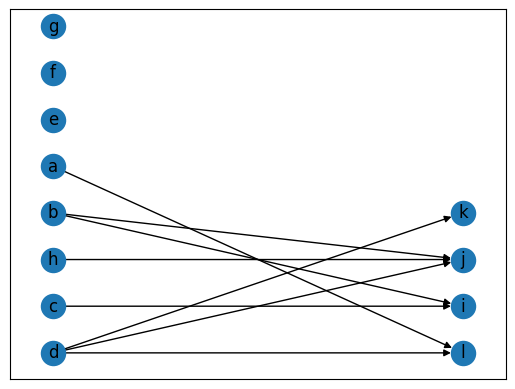

In [4]:


for v in sorted(list(set(L1_nodes).difference(reassigned))):
    
    try:
        reordered[reordered.index("_")]=v
    except ValueError:
        if v not in reordered:
            reordered.append(v)

print(reordered)
pos = {}
for e,n in enumerate(ordered):
    pos[n]=(1,e)

for e,n in enumerate(reordered):
    pos[n]=(0,e)     

g = nx.DiGraph()
for n in L1_nodes + L2_nodes:
    g.add_node(n)
for e in edges:
    pass
    g.add_edge(*e)

nx.draw_networkx(g, pos=pos)


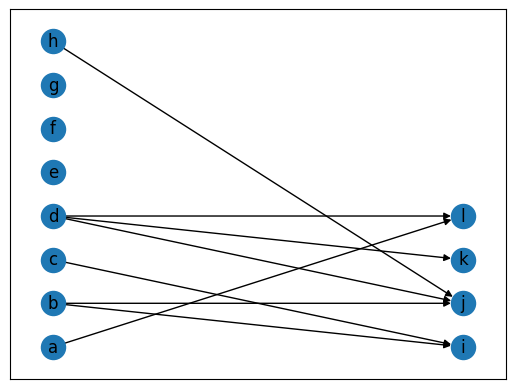

In [5]:

pos = {}
for e,n in enumerate(L1_nodes):
    pos[n]=(0,e)

for e,n in enumerate(L2_nodes):
    pos[n]=(1,e)     
nx.draw_networkx(g, pos=pos)

In [6]:
def bipartite_ordering(L1, L2, Edges):
    assigned=set()
    ordered=[]
    for i,n in enumerate(L1):
        for s,f in sorted(Edges, key = lambda x : x[0]):
            if s==n and f not in assigned:
                latest = len(assigned)
                if i > latest:
                    for j in range(latest, i-1):
                        ordered.insert(i,"_")
                ordered.insert(i,f)
                assigned.add(f)
    
    ordered = [o for o in ordered if o != "_"]

    for v in sorted(list(set(L2).difference(assigned))):
        
        try:
            ordered[ordered.index("_")]=v
        except ValueError:
            if v not in ordered:
                ordered.append(v)
    return ordered

In [7]:
L1_nodes = ["a", "b", "c", "d", "e", "f", "g", "h"]
L2_nodes = ["i", "j", "k", "l", "m", "n", "o", "p","q", "r", "s", "t"]
L1L2Product = itertools.product(L1_nodes, L2_nodes)
edge_count = random.randrange(int(len(L1_nodes)/4), int(len(L1_nodes)*2))
edges = random.sample(list(L1L2Product),edge_count)
L2_ordered = bipartite_ordering(L1_nodes, L2_nodes, edges)
L2_ordered

['m', 's', 'n', 'j', 'o', 't', 'l', 'i', 'k', 'p', 'q', 'r']

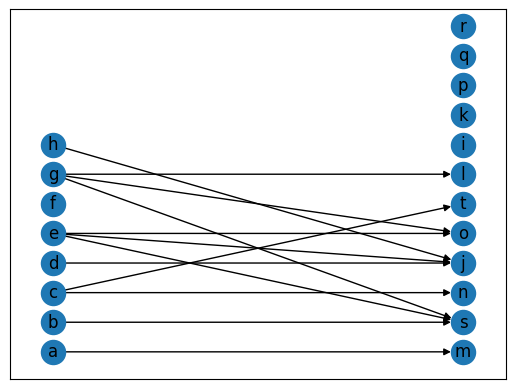

In [8]:

pos = {}
for e,n in enumerate(L1_nodes):
    pos[n]=(0,e)

for e,n in enumerate(L2_ordered):
    pos[n]=(1,e)     
    
g = nx.DiGraph()
for n in L1_nodes + L2_nodes:
    g.add_node(n)
for e in edges:
    pass
    g.add_edge(*e)

nx.draw_networkx(g, pos=pos)


In [9]:
lg_df = pd.read_csv("layer_graph.csv")

In [10]:
def make_id(row):
    return ".".join([str(row['connection']), str(row['dataset']), str(row['tableName'])])
    
    

In [11]:
lg_df['id']=lg_df.apply(lambda x : make_id(x), axis=1)
connection_layers = {
    'fdp_datalake_hive' : 0,
    'agi_health_flosc_postgresql' : 1,
    'floss_s3' : 3,
    'bss_ssi_ukhflosc_hive' : 3,
    'bss_ukhflosc_mssql' : 3,
    'bss_ukhflosc_postgres' : 3,
    'filesystem_managed' : 3,
    'BSS_SQL_Marts' : 3,}

In [12]:
lg_df

,project,dataset,tableName,connection,tableType,lastModifiedBy,last ModifiedOn,data type,id
0,202230227NETWORKMEMBERBEENFITS,plantab1_v,plantab1_v,agi_health_flosc_postgresql,PostgreSQL,cartemp,27/02/2023,input data,agi_health_flosc_postgresql.plantab1_v.plantab1_v
1,202230227NETWORKMEMBERBEENFITS,pmi_claims_directive_v,pmi_claims_directive_v,agi_health_flosc_postgresql,PostgreSQL,cartemp,27/02/2023,input data,agi_health_flosc_postgresql.pmi_claims_directi...
2,202230227NETWORKMEMBERBEENFITS,output_base,NaN,filesystem_managed,Filesystem,cartemp,27/02/2023,intermediate storage,filesystem_managed.output_base.nan
3,202230227NETWORKMEMBERBEENFITS,output_base_by_group_size,NaN,filesystem_managed,Filesystem,cartemp,27/02/2023,intermediate storage,filesystem_managed.output_base_by_group_size.nan
4,20230207DIRECTIVEVOLUME,pmi_claims_directive_v,pmi_claims_directive_v,agi_health_flosc_postgresql,PostgreSQL,cartemp,07/02/2023,input data,agi_health_flosc_postgresql.pmi_claims_directi...
...,...,...,...,...,...,...,...,...,...
2689,WAITTIMESQLIK,Surgery_2023,NaN,filesystem_managed,Filesystem,a163101,20/09/2023,intermediate storage,filesystem_managed.Surgery_2023.nan
2690,WAITTIMESQLIK,Surgery_2023,NaN,filesystem_managed,Filesystem,a163101,20/09/2023,intermediate storage,filesystem_managed.Surgery_2023.nan
2691,WAITTIMESQLIK,tu_file,NaN,filesystem_managed,Filesystem,a163101,14/06/2023,intermediate storage,filesystem_managed.tu_file.nan
2692,WAITTIMESQLIK,visit_2018plus,NaN,floss_s3,S3,a163101,13/09/2023,intermediate storage,floss_s3.visit_2018plus.nan


In [13]:
iset = set(lg_df[lg_df['data type']=='input data']['id'].values)
oset = set(lg_df[lg_df['data type']=='output storage']['id'].values)
pset = set(lg_df['project'].values)


In [14]:
set(lg_df['data type'])

{'SSI', 'input data', 'intermediate storage', nan, 'output storage'}

In [15]:
set(lg_df[lg_df['data type']=='SSI']['id'].values)

{'bss_ssi_ukhflosc_hive.gmc_full.gmc_full',
 'bss_ssi_ukhflosc_hive.list_bill.20230810SPINEBILLING_list_bill',
 'bss_ssi_ukhflosc_hive.postcode_areas_counties_regions.postcode_areas_counties_regions',
 'bss_ssi_ukhflosc_hive.postcodes_with_area_details.postcodes_with_area_details'}

In [16]:
set(lg_df[lg_df['data type']=='intermediate storage']['id'].values)

{'floss_s3.active_with_specfinder_speciality.nan',
 'floss_s3.bill_payment_time.nan',
 'floss_s3.Base_Pstages.nan',
 'floss_s3.member_claims_data_with_pcode.nan',
 'floss_s3.Sub_Spec_Weight_Missing_distinct.nan',
 'floss_s3.ons_RP_E0003540_prepared.nan',
 'floss_s3.bills_export.nan',
 'floss_s3.ClaimsLast2Years.nan',
 'filesystem_managed.pmi_claims_directive_v_filtered.nan',
 'filesystem_managed.cqc_ratings.nan',
 'filesystem_managed.QUERY_FOR_SORT_SORTED.nan',
 'floss_s3.knee_quarter_last3.nan',
 'floss_s3.tu_p5_v.nan',
 'floss_s3.mhp_average_send.nan',
 'floss_s3.provider_usage.nan',
 'filesystem_managed.sme_poss_canx.nan',
 'floss_s3.auth_data.nan',
 'floss_s3.xray_by_year_copy.nan',
 'floss_s3.n_mri_s.nan',
 'floss_s3.Level_3_mix.nan',
 'floss_s3.cqc_ratings.nan',
 'floss_s3.psychotherapy.nan',
 'floss_s3.pmi_postcode_filt.nan',
 'floss_s3.ons_PT_E0003540_grouped.nan',
 'floss_s3.pmi_claims_past2years.nan',
 'floss_s3.test3.nan',
 'floss_s3.n_p3_s.nan',
 'floss_s3.pmi_claims_3yrs_f

In [17]:
Counter(lg_df[lg_df['data type'].isna()]['tableType'])

Counter({'UploadedFiles': 190, 'FilesInFolder': 18, 'Inline': 1})

In [18]:
layer_dict=dict()
missed_comps=set()
layer_assignments=dict()
for s in iset.union(oset).union(pset):
    components=s.split(".")
    if components[0] not in connection_layers:
        missed_comps.add(components[0])
        layer_assignments[s]=2
    else:
        layer_assignments[s]=connection_layers.get(components[0])
layer_assignments

{'fdp_datalake_hive.vw_acpm_thi_tu_spec_aud.vw_acpm_thi_tu_spec_aud': 0,
 'bss_ukhflosc_mssql.Practitioner_Online_Billing_2023onwards.PRACTITIONERONLINEBILLING_practitioner_online_billing_2023onwards': 3,
 'agi_health_flosc_postgresql.network_reasons_v.network_reasons_v': 1,
 'agi_health_flosc_postgresql.vw_acpm_thi_admit_rights.practitioner_admitrights_v': 1,
 'SPIREERFCONSULTANTS': 2,
 'agi_health_flosc_postgresql.hospital_list_v.hospital_list_v': 1,
 'SF_IN_DATAIKU_POLARS': 2,
 'agi_health_flosc_postgresql.treatment_details_v.treatment_details_v': 1,
 'fdp_datalake_hive.vw_acpm_pob_thi_app_mi_data_valclmauthor.vw_acpm_pob_thi_app_mi_data_valclmauthor': 0,
 'agi_health_flosc_postgresql.policy_status_movement_v.policy_status_movement_v': 1,
 'fdp_datalake_hive.vw_acpm_thi08009.vw_acpm_thi08009': 0,
 'agi_health_flosc_postgresql.plantab1_v.plantab1_v': 1,
 'fdp_datalake_hive.vw_acpm_thi_pat_treatment.vw_acpm_thi_pat_treatment': 0,
 'bss_ukhflosc_mssql.all_members_sub_details.HEALTH_STR

In [19]:
pivot_df = lg_df.pivot_table(index="project", columns="data type", values="id", aggfunc=set)
pivot_df

data type,SSI,input data,intermediate storage,output storage
project,,,,
202230227NETWORKMEMBERBEENFITS,NaN,{agi_health_flosc_postgresql.plantab1_v.planta...,"{filesystem_managed.output_base.nan, filesyste...",NaN
20230207DIRECTIVEVOLUME,NaN,{agi_health_flosc_postgresql.pmi_claims_direct...,{filesystem_managed.pmi_claims_directive_v_fil...,NaN
20230227DIRECTIVESPINEVOLUME,NaN,{agi_health_flosc_postgresql.pmi_claims_direct...,{filesystem_managed.pmi_claims_directive_v_fil...,NaN
20230518TOPGUIDINGPROVIDERS,NaN,{agi_health_flosc_postgresql.pmi_claims_direct...,"{floss_s3.directed_cases.nan, floss_s3.test.na...",NaN
20230606NETWORKAUTHSCOPEDATA,NaN,{agi_health_flosc_postgresql.vw_acpm_thi_visit...,"{floss_s3.output_auth_data.nan, floss_s3.auth_...",NaN
...,...,...,...,...
TREATMENT_UNIT_PIVOT_TABLE,NaN,{agi_health_flosc_postgresql.treatmentunit_det...,NaN,{bss_ukhflosc_postgres.trtmnt_unit_pivot_for_o...
TRUSTCAREHOSPITALSUSAGE,NaN,{agi_health_flosc_postgresql.pmi_claims_v.pmi_...,"{floss_s3.TC_Output.nan, floss_s3.ClaimsLast2Y...",NaN
VEDAFILE,NaN,{fdp_datalake_hive.vw_acpm_thi_sub_catgry.vw_a...,"{floss_s3.lake_condgrouper.nan, floss_s3.ONSPD...",{bss_ukhflosc_postgres.ntw_diag_mapn.ntw_diag_...


In [20]:
ordered_layers = dict()
for i in range(min(layer_assignments.values()), max(layer_assignments.values())+1):
    for k,v in layer_assignments.items():
        if v==i:
            if v in ordered_layers.keys():
                ordered_layers[v].append(k)
            else:
                ordered_layers[v]=[k]

for k,v in ordered_layers.items():
    ordered_layers[k]=sorted(v)

ordered_layers

{0: ['fdp_datalake_hive.hc_appian_policy_detail.hc_appian_policy_detail',
  'fdp_datalake_hive.vw_acpm_pob_thi_app_mi_data_crepayreq.vw_acpm_pob_thi_app_mi_data_crepayreq',
  'fdp_datalake_hive.vw_acpm_pob_thi_app_mi_data_valclmauthor.vw_acpm_pob_thi_app_mi_data_valclmauthor',
  'fdp_datalake_hive.vw_acpm_pob_thi_app_mi_data_valpractioner.vw_acpm_pob_thi_app_mi_data_valpractioner',
  'fdp_datalake_hive.vw_acpm_supplychain_thi_app_mi_data_bookappmnt.vw_acpm_supplychain_thi_app_mi_data_bookappmnt',
  'fdp_datalake_hive.vw_acpm_supplychain_thi_app_mi_data_bookappmnt_1.vw_acpm_supplychain_thi_app_mi_data_bookappmnt',
  'fdp_datalake_hive.vw_acpm_supplychain_thi_app_mi_data_getslot.vw_acpm_supplychain_thi_app_mi_data_getslot',
  'fdp_datalake_hive.vw_acpm_supplychain_thi_sp_avilability.vw_acpm_supplychain_thi_sp_avilability',
  'fdp_datalake_hive.vw_acpm_thi07800.vw_acpm_thi07800',
  'fdp_datalake_hive.vw_acpm_thi07801.vw_acpm_thi07801',
  'fdp_datalake_hive.vw_acpm_thi07802.vw_acpm_thi0780

In [21]:
g = nx.DiGraph()
edges = []
index = pivot_df['input data'].index
for i,r in enumerate(pivot_df['input data']):
    if not pd.isnull(r):
        for val in r:
            if not pd.isnull(val):
                e = (val, index[i])
                edges.append(e)
                g.add_edge(*e)

for i,r in enumerate(pivot_df['output storage']):
    if not pd.isnull(r):
        for val in r:
            if not pd.isnull(val):
                e = (index[i], val)
                edges.append(e)
                g.add_edge(*e)

edges

[('agi_health_flosc_postgresql.plantab1_v.plantab1_v',
  '202230227NETWORKMEMBERBEENFITS'),
 ('agi_health_flosc_postgresql.pmi_claims_directive_v.pmi_claims_directive_v',
  '202230227NETWORKMEMBERBEENFITS'),
 ('agi_health_flosc_postgresql.pmi_claims_directive_v.pmi_claims_directive_v',
  '20230207DIRECTIVEVOLUME'),
 ('agi_health_flosc_postgresql.pmi_claims_directive_v.pmi_claims_directive_v',
  '20230227DIRECTIVESPINEVOLUME'),
 ('agi_health_flosc_postgresql.pmi_claims_directive_v.pmi_claims_directive_v',
  '20230518TOPGUIDINGPROVIDERS'),
 ('agi_health_flosc_postgresql.treatmentunit_details_v.treatmentunit_details_v',
  '20230518TOPGUIDINGPROVIDERS'),
 ('agi_health_flosc_postgresql.vw_acpm_thi_visit.claim_visits_v',
  '20230606NETWORKAUTHSCOPEDATA'),
 ('fdp_datalake_hive.vw_acpm_thi_ntwrk.vw_acpm_thi_ntwrk',
  '20230606NETWORKAUTHSCOPEDATA'),
 ('fdp_datalake_hive.vw_acpm_thi_ntwrk_a_s_typ.vw_acpm_thi_ntwrk_a_s_typ',
  '20230606NETWORKAUTHSCOPEDATA'),
 ('agi_health_flosc_postgresql.pmi_c

In [22]:
[r for r in pivot_df['input data']]


[{'agi_health_flosc_postgresql.plantab1_v.plantab1_v',
  'agi_health_flosc_postgresql.pmi_claims_directive_v.pmi_claims_directive_v'},
 {'agi_health_flosc_postgresql.pmi_claims_directive_v.pmi_claims_directive_v'},
 {'agi_health_flosc_postgresql.pmi_claims_directive_v.pmi_claims_directive_v'},
 {'agi_health_flosc_postgresql.pmi_claims_directive_v.pmi_claims_directive_v',
  'agi_health_flosc_postgresql.treatmentunit_details_v.treatmentunit_details_v'},
 {'agi_health_flosc_postgresql.vw_acpm_thi_visit.claim_visits_v',
  'fdp_datalake_hive.vw_acpm_thi_ntwrk.vw_acpm_thi_ntwrk',
  'fdp_datalake_hive.vw_acpm_thi_ntwrk_a_s_typ.vw_acpm_thi_ntwrk_a_s_typ'},
 {'agi_health_flosc_postgresql.pmi_claims_v.pmi_claims_v',
  'agi_health_flosc_postgresql.practitioner_details_v.practitioner_details_v',
  'agi_health_flosc_postgresql.treatmentunit_details_v.treatmentunit_details_v'},
 {'agi_health_flosc_postgresql.pmi_claims_directive_v.pmi_claims_directive_v',
  'agi_health_flosc_postgresql.pmi_claims_v.

In [23]:
pos = {}
for k,v in ordered_layers.items():
    for e,n in enumerate(v):
        pos[n]=(k,e)
    

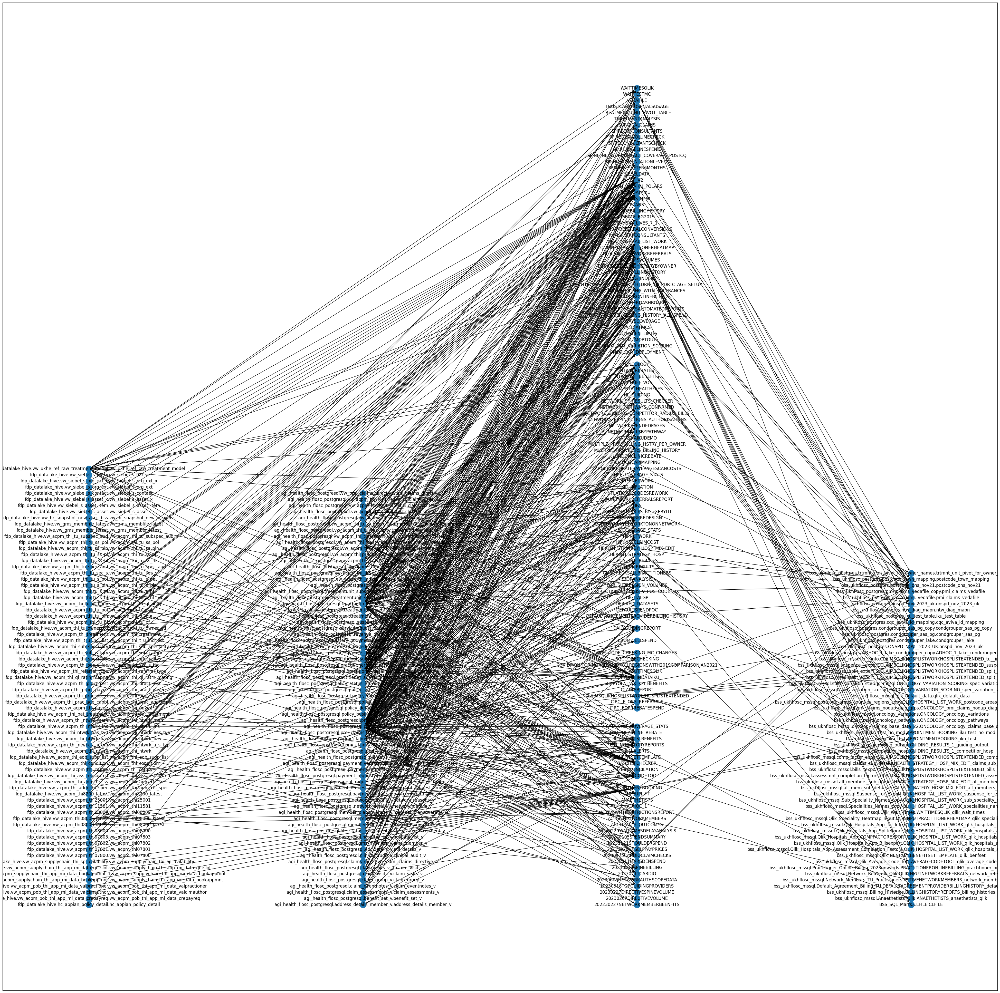

In [24]:
fig=plt.figure(figsize=(50,50))
nx.draw_networkx(g, pos=pos)

In [25]:
nx.is_weakly_connected(g), nx.number_weakly_connected_components(g)

(True, 1)

In [26]:
topological_layer_assignments = {n:e for e,l in enumerate(nx.topological_generations(g)) for n in l}

In [27]:
for e,l in enumerate(nx.topological_generations(g)):
    for n in l:
        print (e,layer_assignments[n])

0 1
0 1
0 1
0 1
0 0
0 0
0 1
0 1
0 1
0 0
0 0
0 0
0 0
0 1
0 1
0 1
0 1
0 1
0 0
0 0
0 0
0 0
0 0
0 0
0 1
0 1
0 1
0 0
0 1
0 0
0 0
0 0
0 1
0 0
0 1
0 1
0 0
0 0
0 0
0 0
0 1
0 1
0 0
0 1
0 0
0 1
0 0
0 1
0 0
0 1
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 1
0 0
0 0
0 1
0 1
0 1
0 0
0 0
0 1
0 1
0 0
0 0
0 0
0 0
0 0
0 1
0 0
0 0
0 1
0 1
0 1
0 0
0 1
0 1
0 1
0 1
0 1
0 0
0 1
0 1
0 1
0 0
0 0
0 0
0 0
0 0
0 1
0 1
0 1
0 1
0 1
0 1
0 0
0 0
0 0
0 1
0 1
0 1
0 1
0 0
0 1
0 1
0 0
0 0
0 1
0 1
0 0
0 0
0 1
0 1
0 1
0 1
0 1
0 0
0 1
0 1
0 0
0 0
0 0
0 0
0 1
0 0
0 0
0 0
0 1
0 1
0 0
0 0
0 0
0 0
0 1
0 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2
1 2


In [28]:
pageranked_nodes = sorted([(n,r) for n,r in nx.pagerank(g).items()], key=lambda x: x[1])

/home/tomk/environment/devpy/lib/python3.10/site-packages/scipy/__init__.py:155: UserWarning: A NumPy version >=1.18.5 and <1.25.0 is required for this version of SciPy (detected version 1.26.4
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [29]:
def align_pos(pos):
    new_pos={}
    max_y = max([y for x,y in pos.values()])
    min_y = min([y for x,y in pos.values()])
    max_x = max([x for x,y in pos.values()])
    min_x = min([x for x,y in pos.values()])


def align_pos(layers):
    l_count = dict()
    for k,v in layers.items():
        l_count[k]=len(v)
    max_count = max(l_count.values())
    pos = {}
    for k,v in layers.items():
        for e,n in enumerate(v):
            pos[n]=(k,e*(max_count/l_count[k]))
    return pos

In [30]:
pos = {}
for e,pr in enumerate(pageranked_nodes):
    k,v = pr
    pos[k]=(layer_assignments[k],e)
    

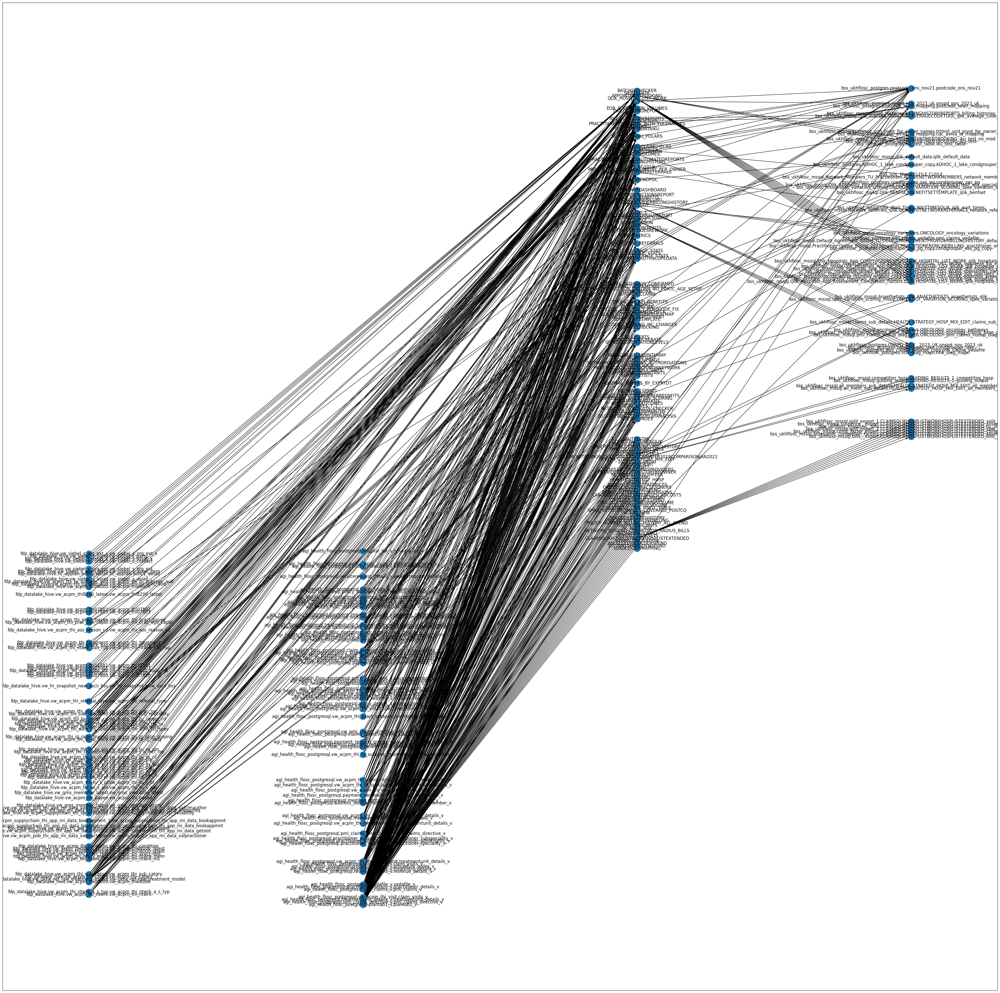

In [31]:
fig=plt.figure(figsize=(50,50))
nx.draw_networkx(g, pos=pos)

In [32]:
pos=align_pos(ordered_layers)

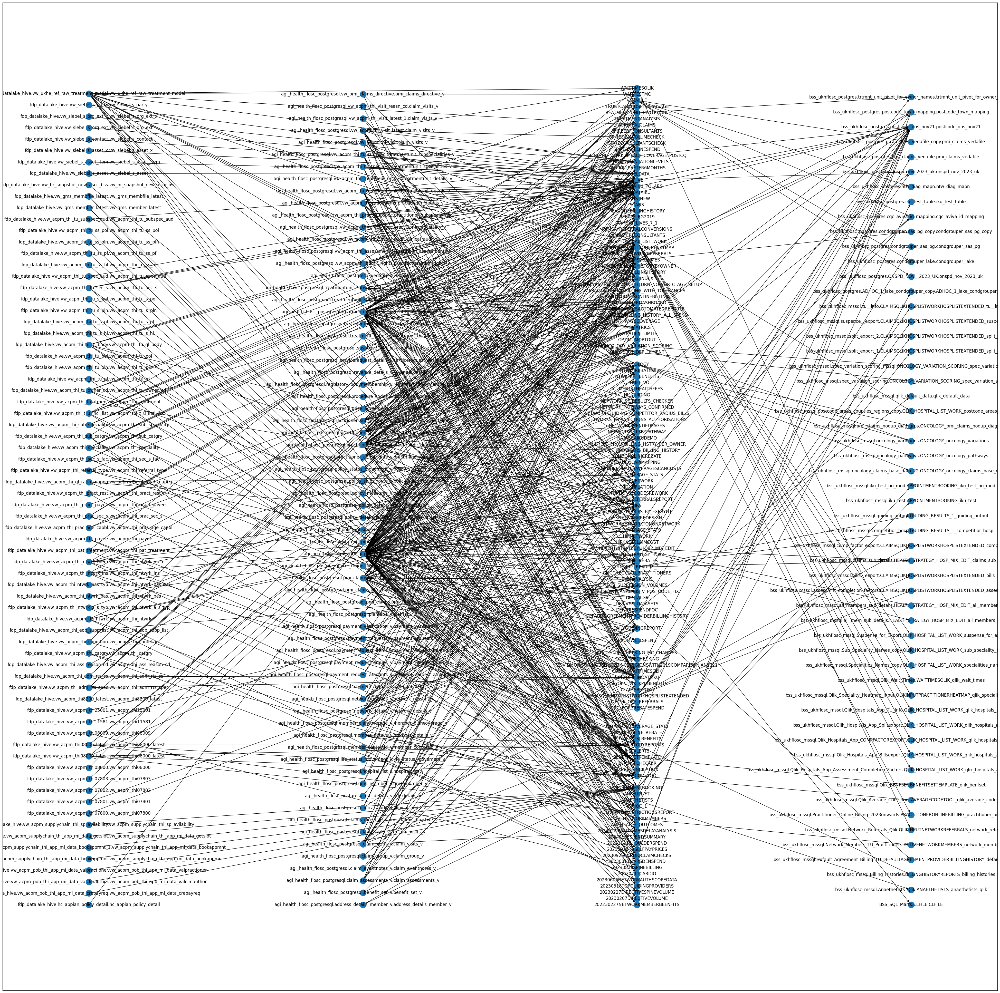

In [33]:
fig=plt.figure(figsize=(50,50))
nx.draw_networkx(g, pos=pos)

In [34]:
fig.savefig("claims_bss.svg")

In [35]:
alt_ordered_layers = dict()
for i in range(min(topological_layer_assignments.values()), max(topological_layer_assignments.values())+1):
    for k,v in topological_layer_assignments.items():
        if v==i:
            if v in alt_ordered_layers.keys():
                alt_ordered_layers[v].append(k)
            else:
                alt_ordered_layers[v]=[k]

for k,v in alt_ordered_layers.items():
    alt_ordered_layers[k]=sorted(v)

alt_ordered_layers

{0: ['LOADCQCAPIMAPPING',
  'agi_health_flosc_postgresql.address_details_member_v.address_details_member_v',
  'agi_health_flosc_postgresql.benefit_set_v.benefit_set_v',
  'agi_health_flosc_postgresql.claim_assessments_v.claim_assessments_v',
  'agi_health_flosc_postgresql.claim_eventnotes_v.claim_eventnotes_v',
  'agi_health_flosc_postgresql.claim_group_v.claim_group_v',
  'agi_health_flosc_postgresql.claim_visits_v.claim_visits_v',
  'agi_health_flosc_postgresql.claim_visits_v_1.claim_visits_v',
  'agi_health_flosc_postgresql.claims_directive_v.pmi_claims_directive_v',
  'agi_health_flosc_postgresql.clinical_audit_v.clinical_audit_v',
  'agi_health_flosc_postgresql.edi_details_v.edi_details_v',
  'agi_health_flosc_postgresql.gms_member_v.gms_member_v',
  'agi_health_flosc_postgresql.hospital_list_v.hospital_list_v',
  'agi_health_flosc_postgresql.life_status_movement_v.life_status_movement_v',
  'agi_health_flosc_postgresql.member_contactid_v.member_contactid_v',
  'agi_health_flosc_

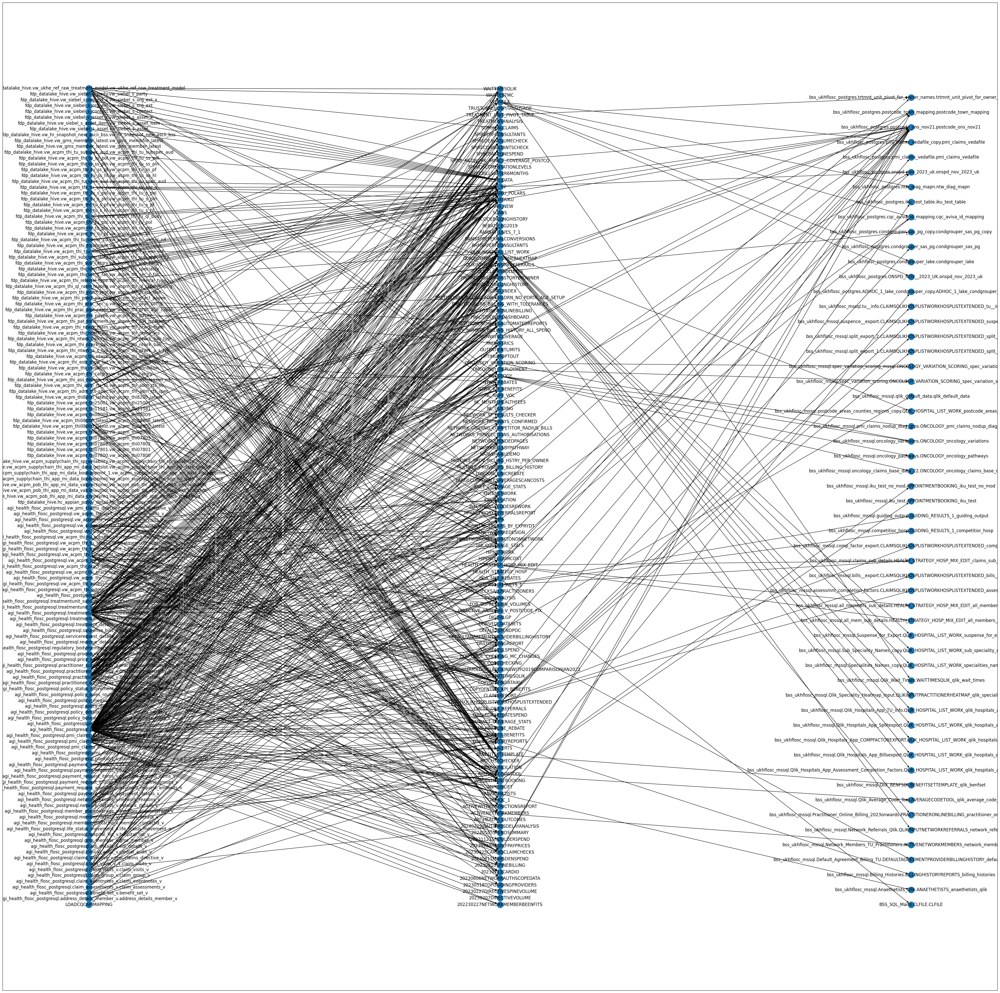

In [36]:
pos=align_pos(alt_ordered_layers)
fig=plt.figure(figsize=(50,50))
nx.draw_networkx(g, pos=pos)

In [37]:
sources = [n for n,d in g.in_degree() if d==0]
sinks = [n for n,d in g.out_degree() if d==0]
print(len(sources), len(sinks))
paths=[]
for s in sources:
    for f in sinks:
        paths.extend(nx.all_simple_paths(g,s,f))

141 140


In [38]:
node_participation={}
for n in g.nodes():
    for p in paths:
        if n in set(p):
            if n in node_participation:
                node_participation[n]=node_participation[n]+1
            else:
                node_participation[n]=1
n_psorted = sorted([(n,p) for n,p in node_participation.items()], key=lambda x: x[1])

Text(0.5, 1.0, 'Path participation')

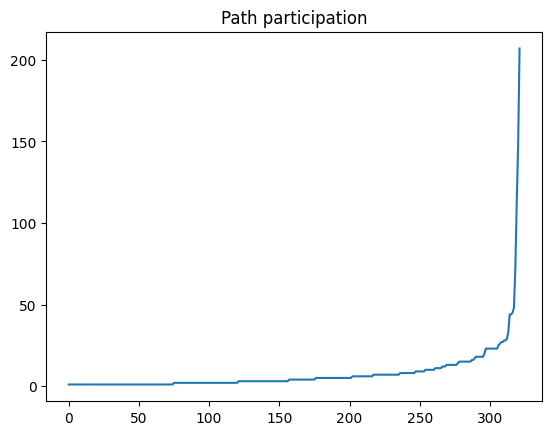

In [39]:
data = [v[1] for v in n_psorted]
names = [v[0] for v in n_psorted]
plt.plot(data)
plt.title("Path participation")
#plt.yscale("log")

In [40]:
node_degree_product={}
for n in g.nodes():
   node_participation[n]=((1+g.in_degree(n)) * (1+g.out_degree(n) ))-1
ndp_sorted = sorted([(n,p) for n,p in node_participation.items() if p!=0],key=lambda x:x[1])
ndp_sorted

[('20230207DIRECTIVEVOLUME', 1),
 ('20230227DIRECTIVESPINEVOLUME', 1),
 ('fdp_datalake_hive.vw_acpm_thi08009.vw_acpm_thi08009', 1),
 ('20230811MARSDENSPEND', 1),
 ('agi_health_flosc_postgresql.revenue_details_v.revenue_details_v', 1),
 ('agi_health_flosc_postgresql.procedure_codes_v.procedure_codes_v', 1),
 ('20231121SHOULDERSPEND', 1),
 ('fdp_datalake_hive.vw_acpm_thi_pract_rest.vw_acpm_thi_pract_rest', 1),
 ('fdp_datalake_hive.vw_acpm_pob_thi_app_mi_data_valpractioner.vw_acpm_pob_thi_app_mi_data_valpractioner',
  1),
 ('agi_health_flosc_postgresql.pmi_claims_directive_v_1.pmi_claims_directive_v',
  1),
 ('fdp_datalake_hive.vw_acpm_supplychain_thi_app_mi_data_getslot.vw_acpm_supplychain_thi_app_mi_data_getslot',
  1),
 ('fdp_datalake_hive.vw_acpm_supplychain_thi_app_mi_data_bookappmnt.vw_acpm_supplychain_thi_app_mi_data_bookappmnt',
  1),
 ('agi_health_flosc_postgresql.vw_acpm_thi_treatment_unit_1.treatmentunit_details_v',
  1),
 ('fdp_datalake_hive.vw_acpm_supplychain_thi_app_mi_data

Text(0.5, 1.0, 'Node Degree Product')

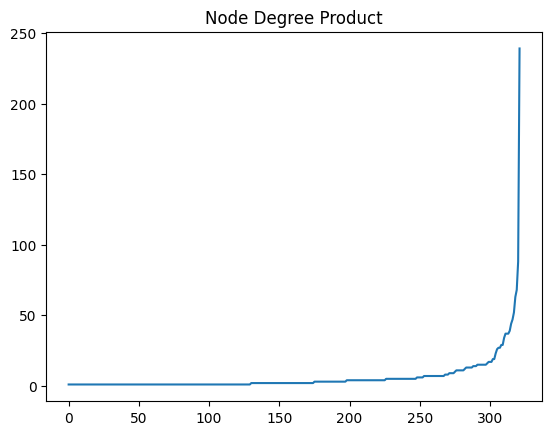

In [41]:
data = [v[1] for v in ndp_sorted]
names = [v[0] for v in ndp_sorted]
plt.plot(data)
plt.title("Node Degree Product")
#plt.yscale("log")

In [42]:
ndp_d = dict(ndp_sorted)
np_d = dict(n_psorted)
scatter_d = dict()
for k in ndp_d.keys():
    scatter_d[k]=(ndp_d[k], np_d[k])

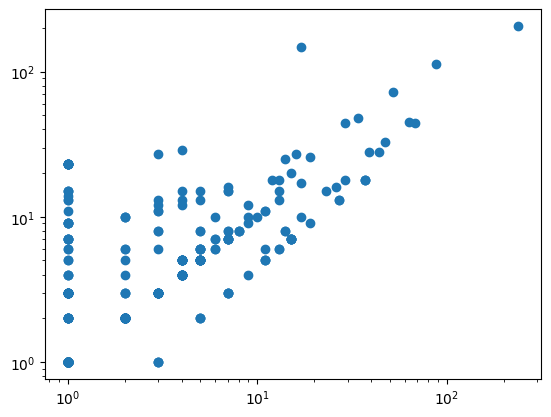

In [43]:
datax, datay = zip(*list(scatter_d.values()))
names = scatter_d.keys()
plt.scatter(x=datax, y=datay, label=names)
plt.yscale("log")
plt.xscale("log")

In [44]:
import gravis as gv

In [45]:
crude_order={n:e for e,(n,v) in enumerate(n_psorted[::-1])}
new_ordered_layers=dict()
for l in ordered_layers.keys():
    layer_c = sorted([(n,crude_order.get(n,9999)) for n in ordered_layers[l]], key=lambda x : x[1])
    new_ordered_layers[l]=[n for n,p in layer_c]

pos=align_pos(new_ordered_layers)

In [46]:
x_vals_d = {n:v[0]*800 for n,v in pos.items()}
y_vals_d = {n:v[1]*10 for n,v in pos.items()}
nx.set_node_attributes(g, x_vals_d, 'x')
nx.set_node_attributes(g, y_vals_d, 'y')


In [47]:
gjgf=gv.convert.networkx_to_gjgf(g.subgraph([n for n,v in n_psorted if (v>0 and v<20000)]))

In [48]:
#gv.d3(gjgf)

In [49]:
from scipy.cluster.hierarchy import linkage, dendrogram, fcluster, maxRstat, inconsistent, cophenet, maxinconsts

In [50]:
adj=nx.to_numpy_array(g)

In [51]:
UT = np.triu(adj)
LT = np.tril(adj)

In [52]:
clinks = linkage(np.array(adj),'ward')

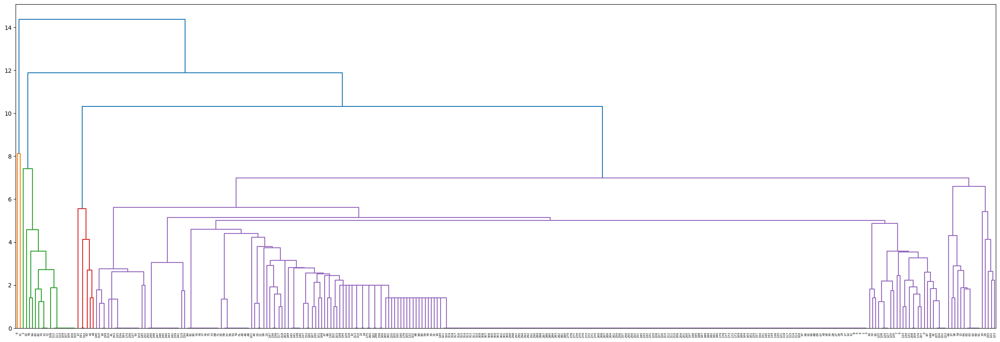

In [53]:
fig=plt.figure(figsize=(30,10))
dn = dendrogram(clinks)

In [54]:
clusters = fcluster(clinks,t=2,criterion='distance')
n_clusts = {}
for e,n in enumerate(g.nodes()):
    n_clusts[n] = clusters[e]

In [55]:
{k:v for k,v in n_clusts.items() if v==9}

{'agi_health_flosc_postgresql.practitioner_speciality_v.practitioner_speciality_v': 9,
 'agi_health_flosc_postgresql.practitioner_subspeciality_v.practitioner_subspeciality_v': 9}